In [1]:
import xarray as xr
import dask
import numpy as np
import act.io.armfiles

In [2]:
import matplotlib.pyplot as plt
import xarray as xr
from netCDF4 import Dataset
import netCDF4
import pyart
import pandas as pd
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import metpy
from matplotlib.dates import DateFormatter


## You are using the Python ARM Radar Toolkit (Py-ART), an open source
## library for working with weather radar data. Py-ART is partly
## supported by the U.S. Department of Energy as part of the Atmospheric
## Radiation Measurement (ARM) Climate Research Facility, an Office of
## Science user facility.
##
## If you use this software to prepare a publication, please cite:
##
##     JJ Helmus and SM Collis, JORS 2016, doi: 10.5334/jors.119



In [3]:
from pyart.testing import get_test_data
import fsspec
from metpy.plots import USCOUNTIES
import warnings
warnings.filterwarnings("ignore")
import glob
import os

In [4]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231004/*.nc')

In [5]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-04T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 29/01/2024 22:14:46 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

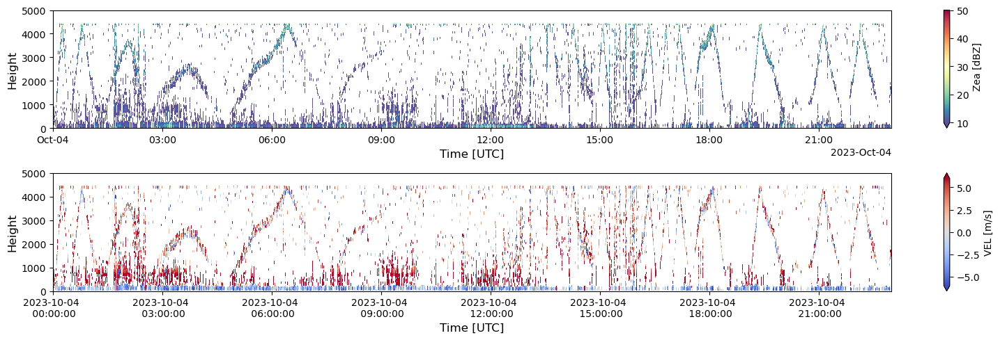

In [6]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
#plt.savefig('October 4th Processed.png', dpi=300, bbox_inches='tight')

In [31]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231005/*.nc')

In [32]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-05T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 30/01/2024 17:34:12 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

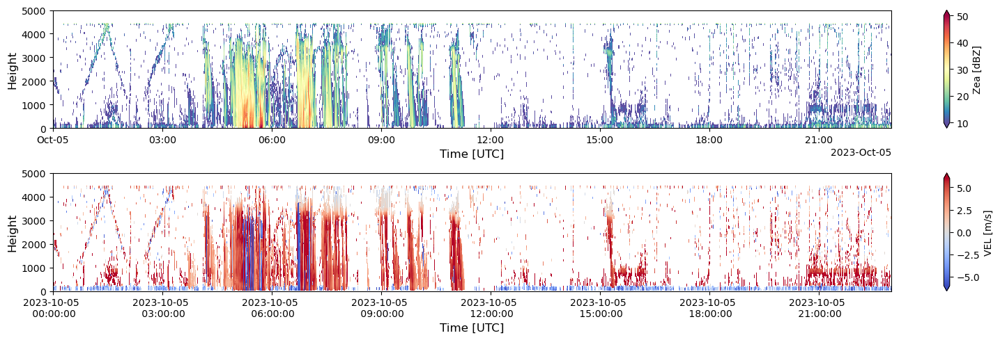

In [33]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 5th Processed.png', dpi=300, bbox_inches='tight')

In [34]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231006/*.nc')

In [35]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-06T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 30/01/2024 17:50:21 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

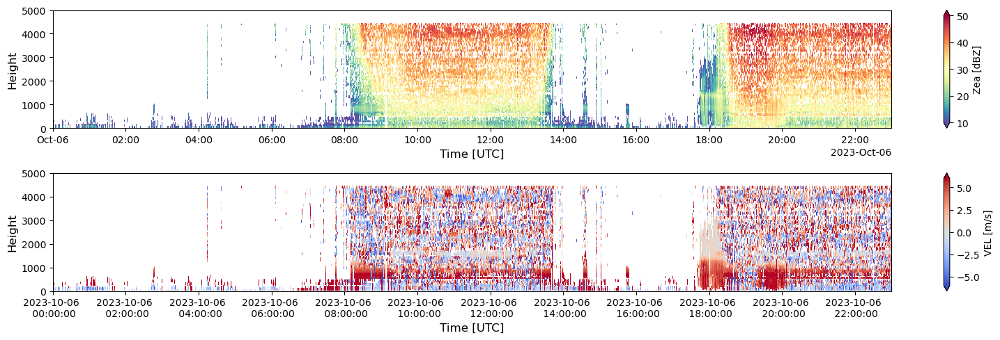

In [36]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 6th Processed.png', dpi=300, bbox_inches='tight')

In [13]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231011/*.nc')

In [14]:
ds

<xarray.Dataset>
Dimensions:                       (time: 7920, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-11T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 30/01/2024 18:06:55 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

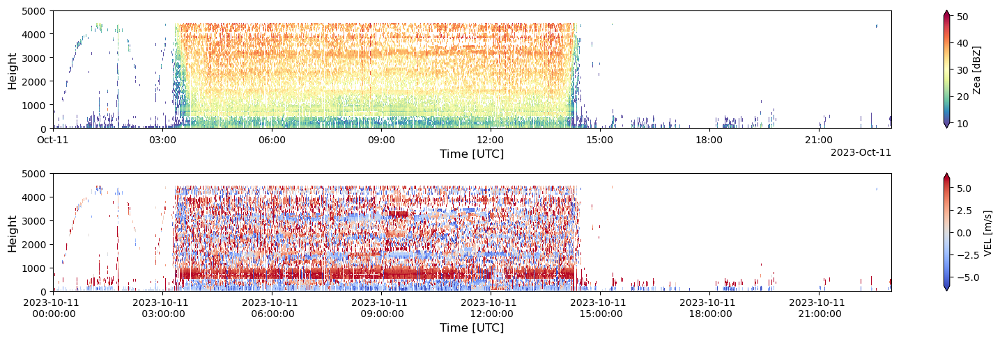

In [15]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
#plt.savefig('October 11th Processed.png', dpi=300, bbox_inches='tight')

In [37]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231012/*.nc')

In [38]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-12T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 30/01/2024 18:27:23 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

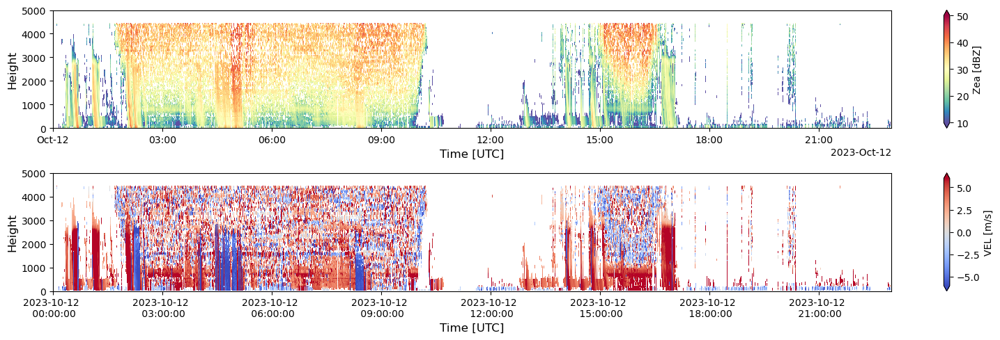

In [39]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 12th Processed.png', dpi=300, bbox_inches='tight')

In [40]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231013/*.nc')

In [41]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-13T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 30/01/2024 18:46:38 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

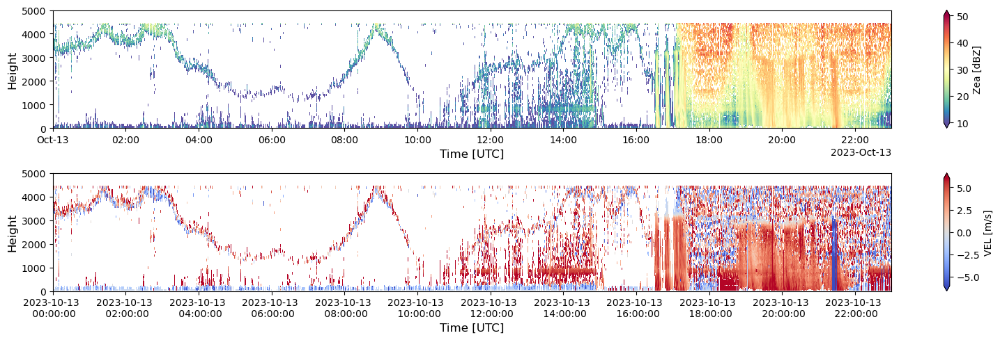

In [42]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 13th Processed.png', dpi=300, bbox_inches='tight')

In [43]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231014/*.nc')

In [44]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-14T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 30/01/2024 19:27:28 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

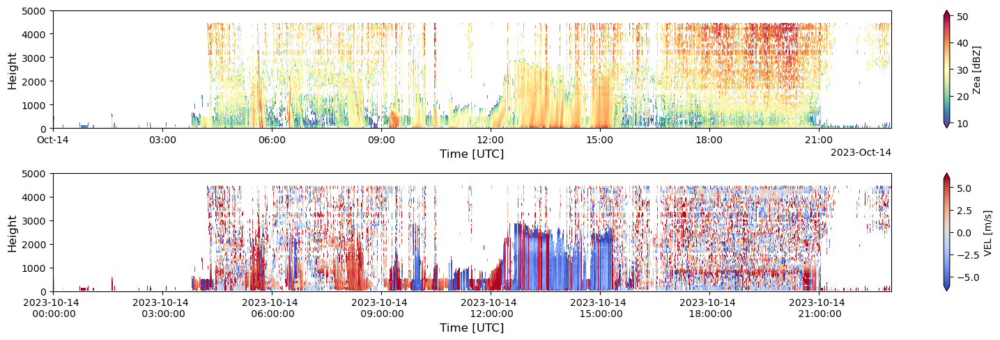

In [45]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 14th Processed.png', dpi=300, bbox_inches='tight')

In [46]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231015/*.nc')

In [47]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-15T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 30/01/2024 19:47:41 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

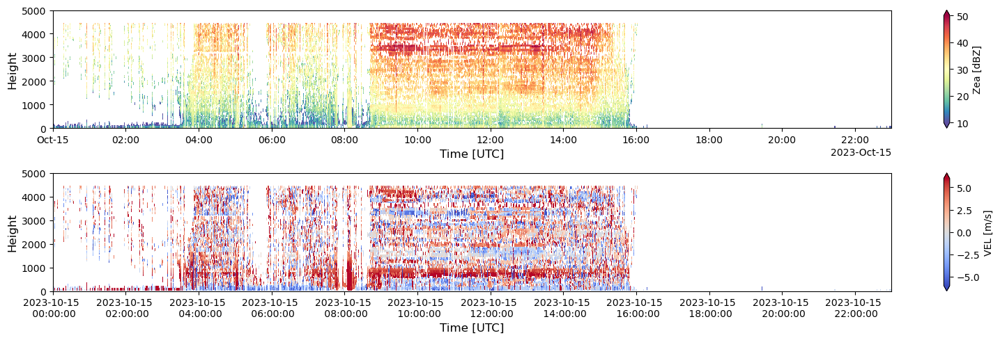

In [48]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 15th Processed.png', dpi=300, bbox_inches='tight')

In [29]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231018/*.nc')

In [30]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-18T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 30/01/2024 20:08:02 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

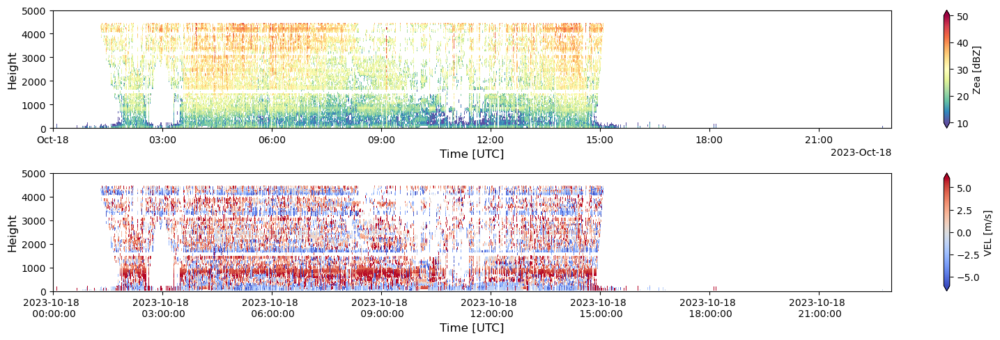

In [31]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
#plt.savefig('October 18th Processed.png', dpi=300, bbox_inches='tight')

In [49]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231019/*.nc')

In [50]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-19T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 30/01/2024 22:07:51 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

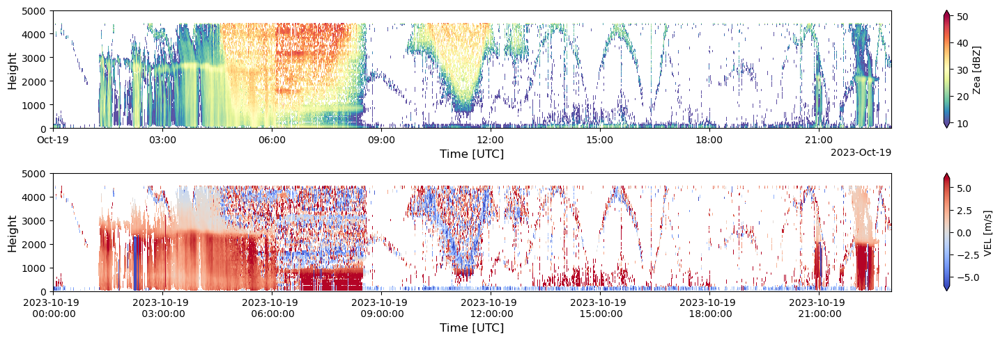

In [51]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 19th Processed.png', dpi=300, bbox_inches='tight')

In [52]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231020/*.nc')

In [53]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8100, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-20T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 30/01/2024 22:28:09 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

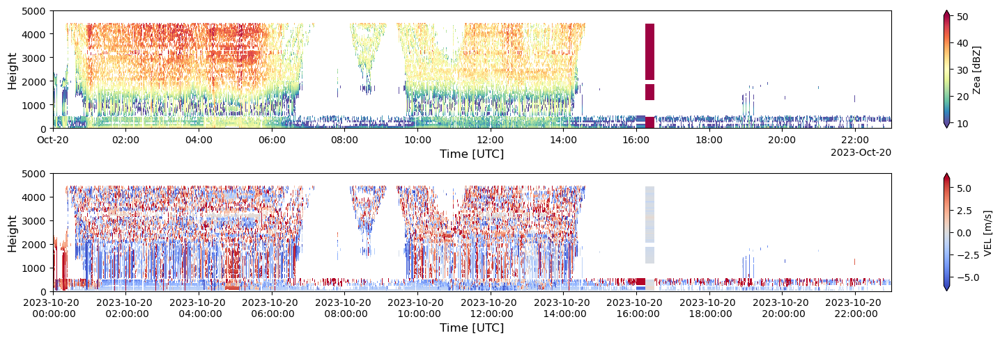

In [54]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 20th Processed.png', dpi=300, bbox_inches='tight')

In [38]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231024/*.nc')

In [39]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-24T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 17:01:59 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

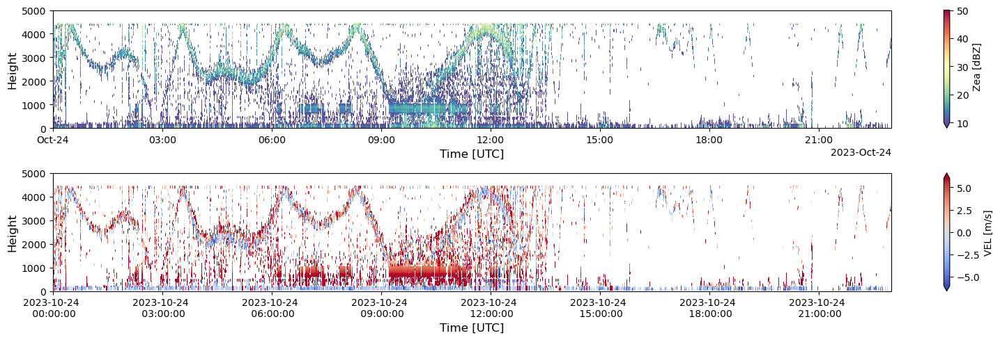

In [40]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
#plt.savefig('October 24th Processed.png', dpi=300, bbox_inches='tight')

In [55]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231025/*.nc')

In [56]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-25T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 17:17:52 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

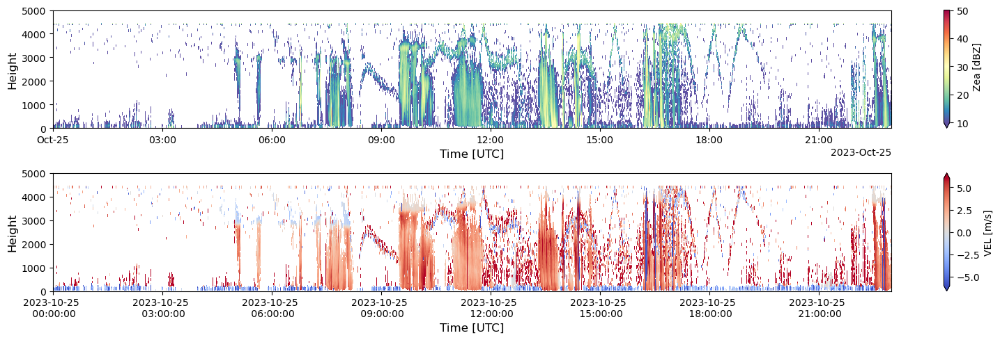

In [57]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 25th Processed.png', dpi=300, bbox_inches='tight')

In [58]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231026/*.nc')

In [59]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-26T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 17:31:47 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

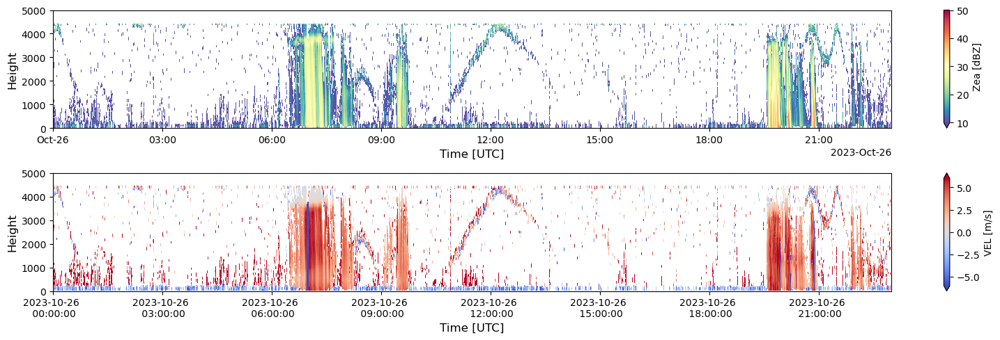

In [60]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 26th Processed.png', dpi=300, bbox_inches='tight')

In [61]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231027/*.nc')

In [62]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-27T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 17:49:49 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

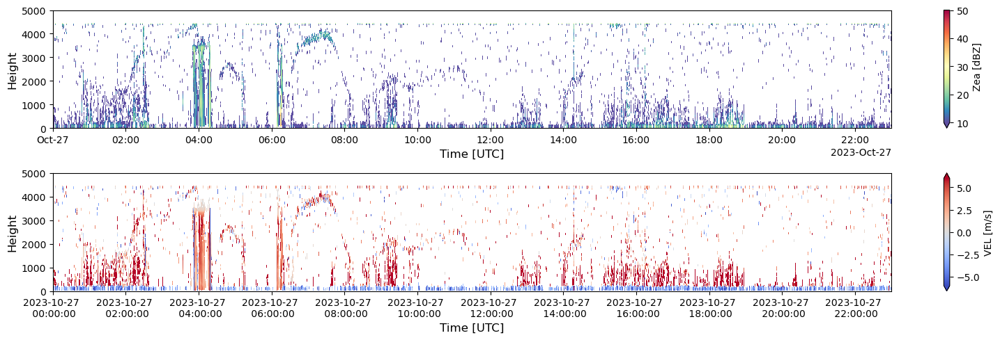

In [63]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 27th Processed.png', dpi=300, bbox_inches='tight')

In [64]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231028/*.nc')

In [65]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-28T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 18:02:32 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

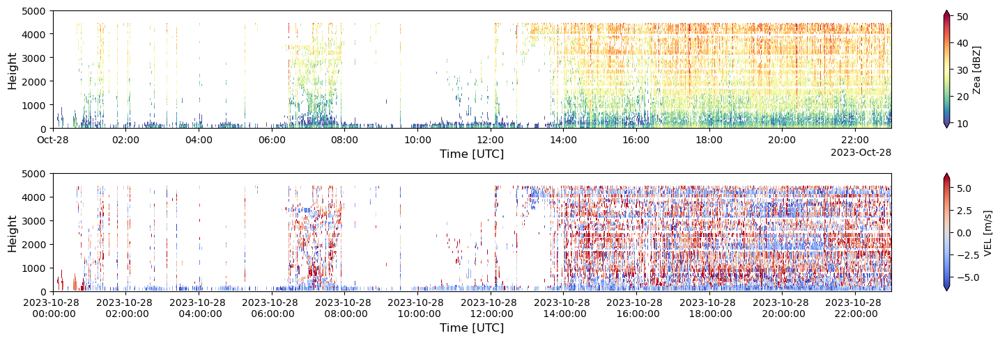

In [66]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 28th Processed.png', dpi=300, bbox_inches='tight')

In [67]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231029/*.nc')

In [68]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-29T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 18:17:03 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

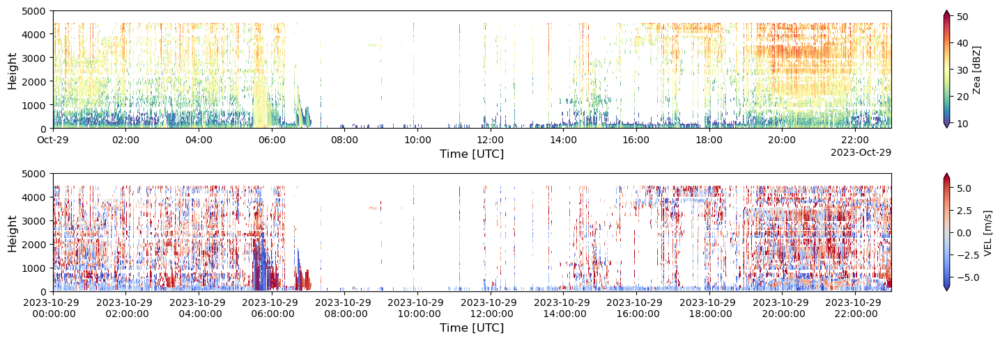

In [69]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 29th Processed.png', dpi=300, bbox_inches='tight')

In [56]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231030/*.nc')

In [57]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-30T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 18:37:46 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

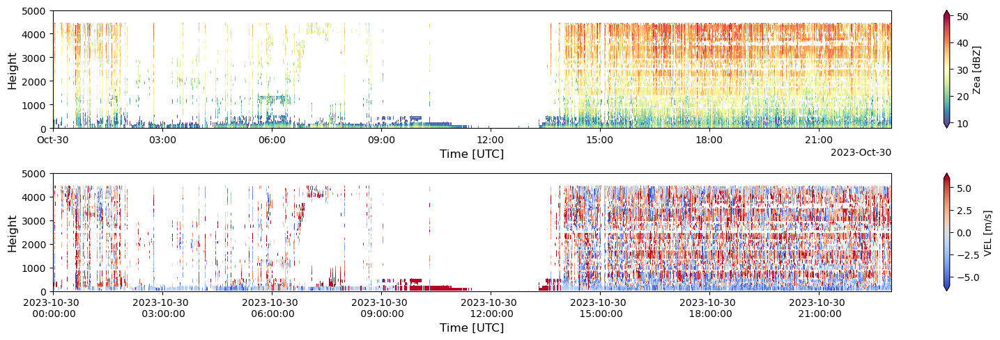

In [58]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
#plt.savefig('October 30th Processed.png', dpi=300, bbox_inches='tight')

In [70]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202310/20231031/*.nc')

In [71]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-10-31T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 18:51:39 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

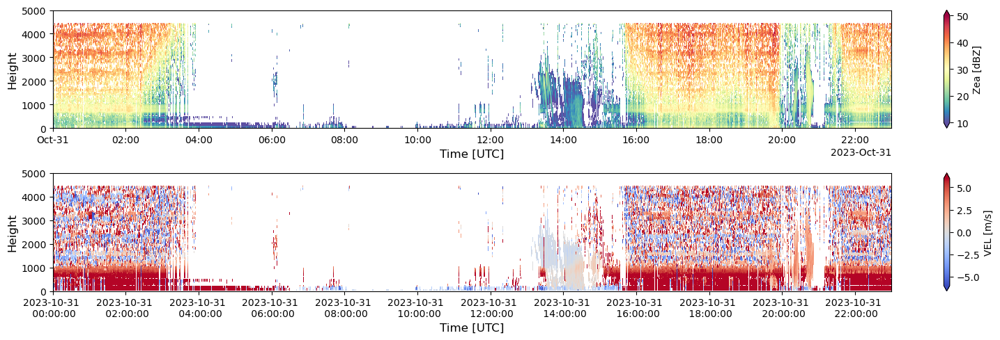

In [72]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('October 31st Processed.png', dpi=300, bbox_inches='tight')

In [73]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202311/20231101/*.nc')

In [74]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-11-01T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 20:04:23 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

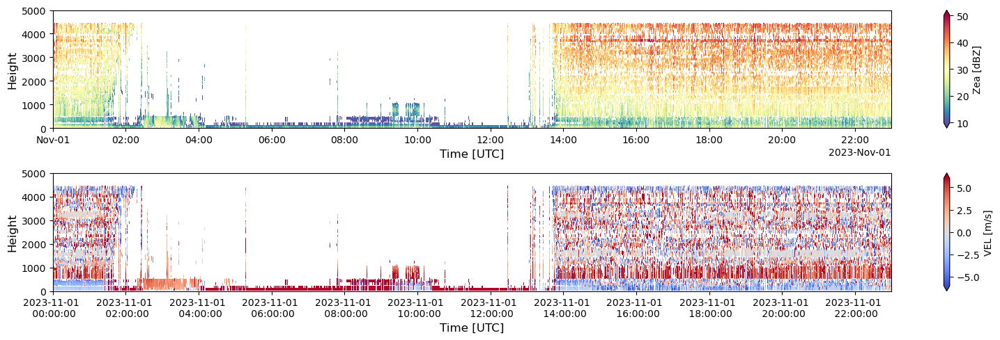

In [75]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Nov 1st Processed.png', dpi=300, bbox_inches='tight')

In [7]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202311/20231103/*.nc')

In [8]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-11-03T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 20:24:33 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

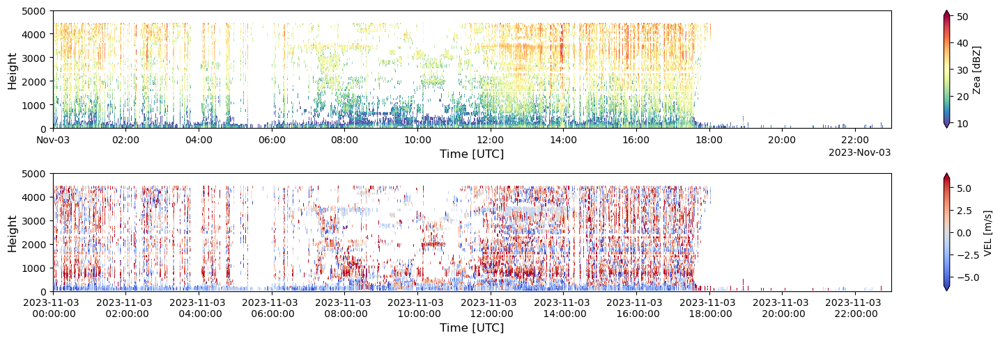

In [9]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
#plt.savefig('Nov 3rd Processed.png', dpi=300, bbox_inches='tight')

In [76]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202311/20231104/*.nc')

In [77]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-11-04T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 20:35:19 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

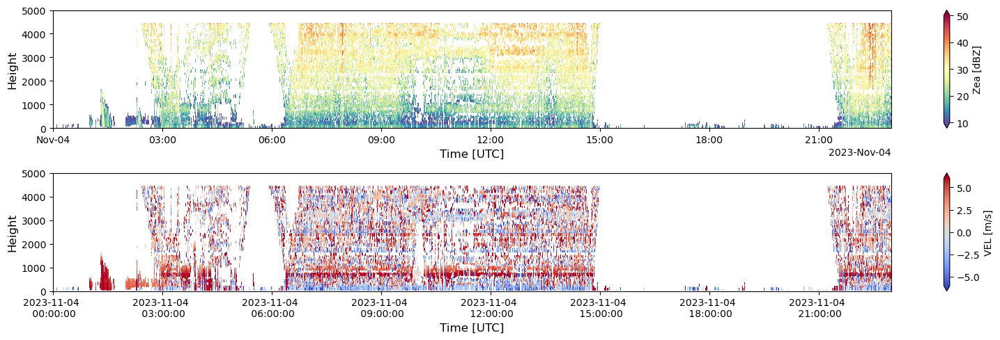

In [78]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Nov 4th Processed.png', dpi=300, bbox_inches='tight')

In [13]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202311/20231107/*.nc')

In [14]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-11-07T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 20:49:46 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

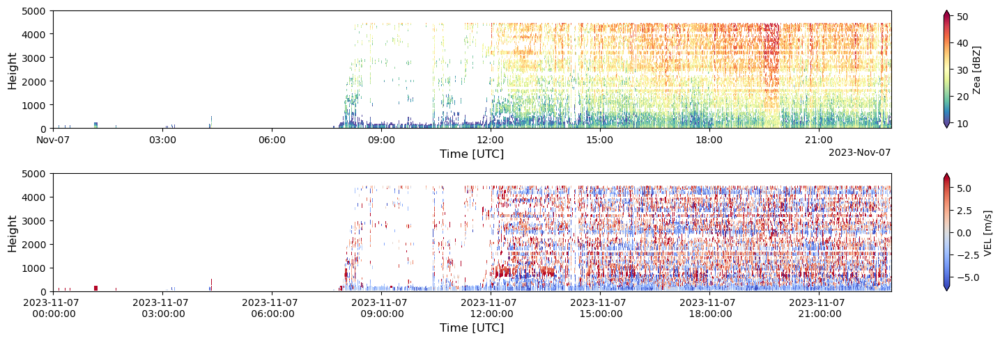

In [15]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
#plt.savefig('Nov 7th Processed.png', dpi=300, bbox_inches='tight')

In [79]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202311/20231108/*.nc')

In [80]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-11-08T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 21:04:50 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

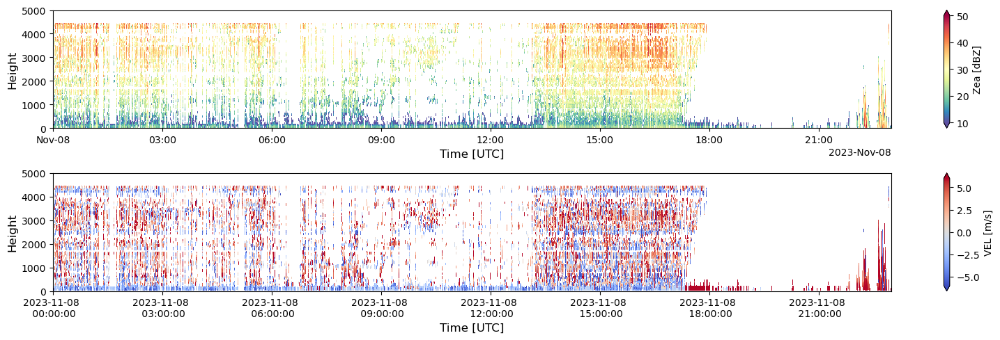

In [81]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Nov 8th Processed.png', dpi=300, bbox_inches='tight')

In [19]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202311/20231116/*.nc')

In [20]:
ds

<xarray.Dataset>
Dimensions:                       (time: 6120, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-11-16T01:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 21:16:50 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

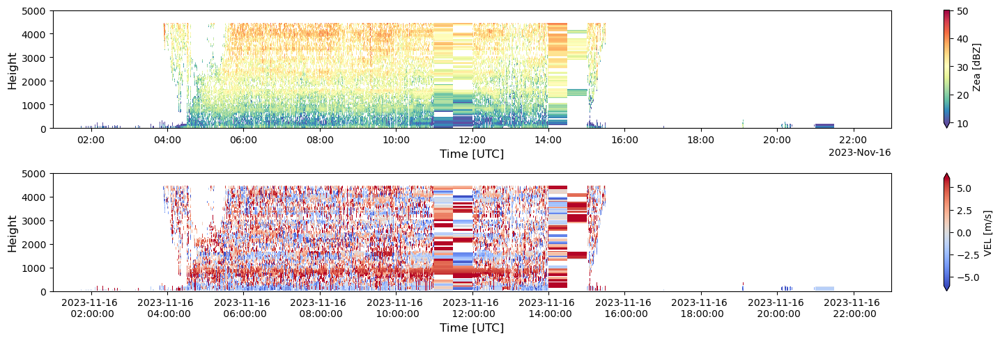

In [21]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
#plt.savefig('Nov 16th Processed.png', dpi=300, bbox_inches='tight')

In [82]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202311/20231117/*.nc')

In [83]:
ds

<xarray.Dataset>
Dimensions:                       (time: 6840, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-11-17T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 21:28:07 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

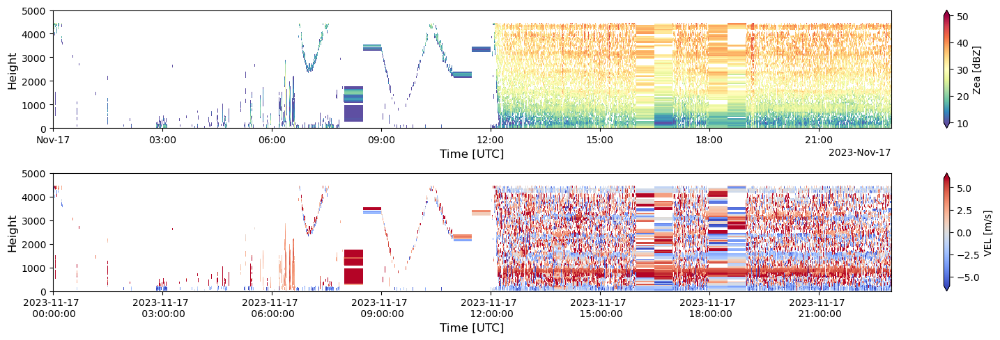

In [84]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Nov 17th Processed.png', dpi=300, bbox_inches='tight')

In [25]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202311/20231120/*.nc')

In [26]:
ds

<xarray.Dataset>
Dimensions:                       (time: 6480, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-11-20T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 21:44:31 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

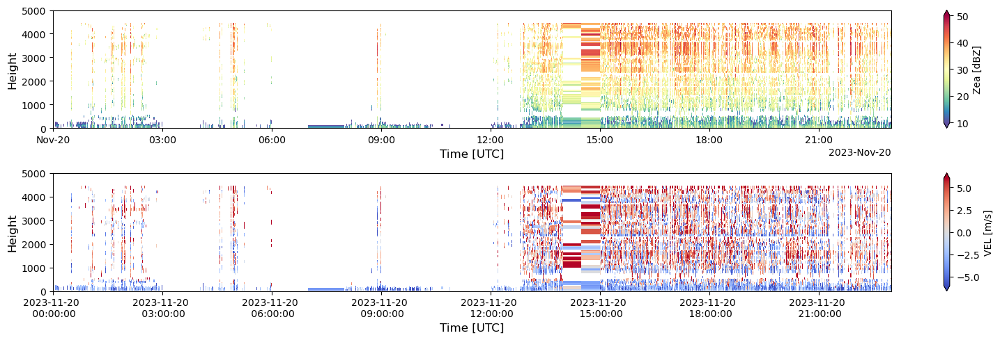

In [27]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
#plt.savefig('Nov 20th Processed.png', dpi=300, bbox_inches='tight')

In [85]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202311/20231121/*.nc')

In [86]:
ds

<xarray.Dataset>
Dimensions:                       (time: 6480, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-11-21T01:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 31/01/2024 21:58:08 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

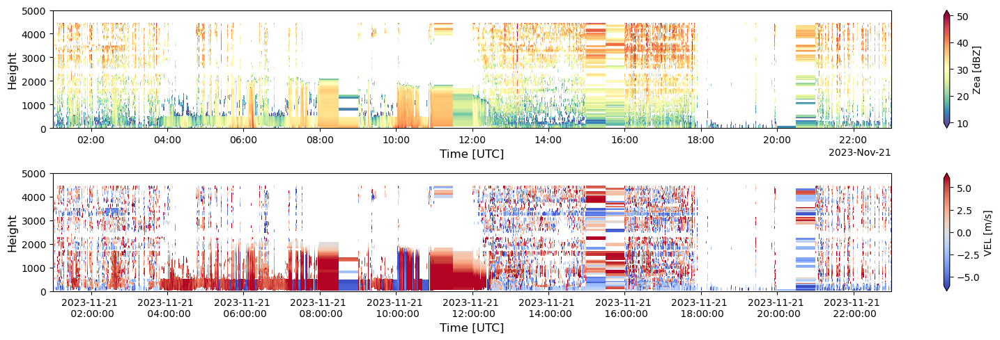

In [87]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Nov 21st Processed.png', dpi=300, bbox_inches='tight')

In [61]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202312/20231201/*.nc')

In [62]:
ds

<xarray.Dataset>
Dimensions:                       (time: 5400, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-12-01T01:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 06/02/2024 22:22:17 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

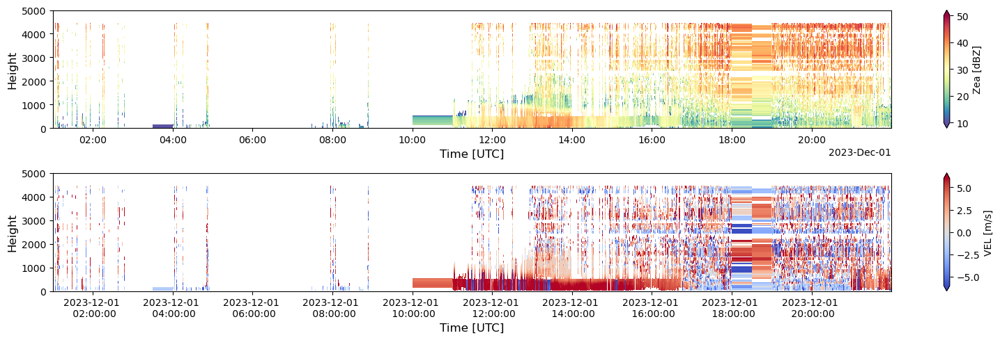

In [63]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Dec 1st Processed.png', dpi=300, bbox_inches='tight')

In [64]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202312/20231203/*.nc')

In [65]:
ds

<xarray.Dataset>
Dimensions:                       (time: 6840, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-12-03T02:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 07/02/2024 21:36:09 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

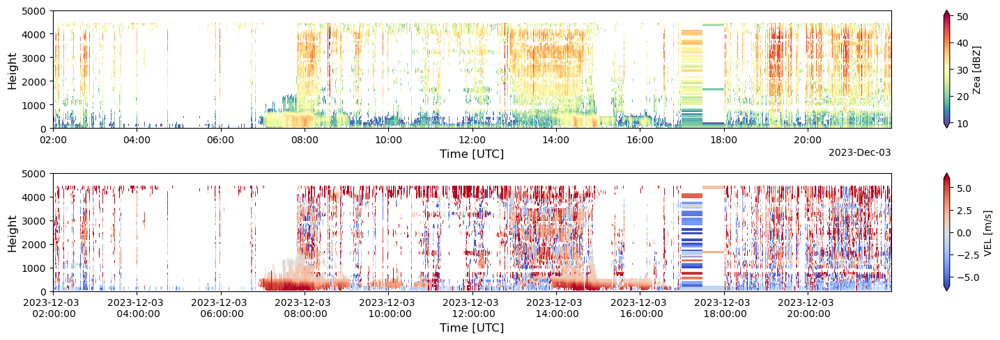

In [66]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Dec 3rd Processed.png', dpi=300, bbox_inches='tight')

In [67]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202312/20231211/*.nc')

In [68]:
ds

<xarray.Dataset>
Dimensions:                       (time: 5760, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-12-11T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 07/02/2024 21:50:24 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

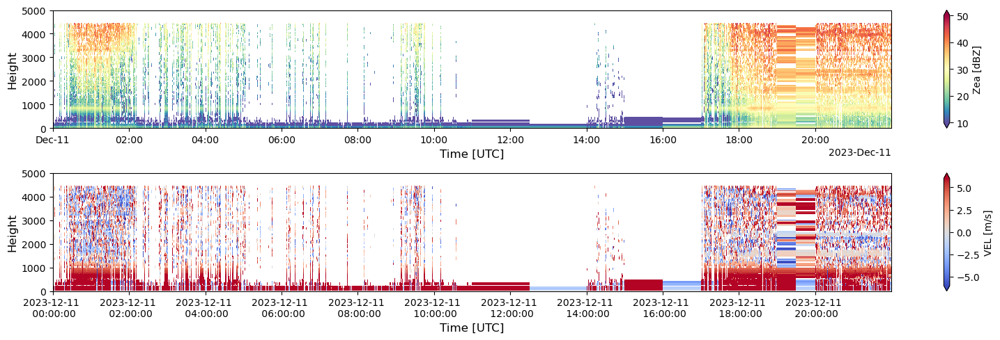

In [69]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Dec 11th Processed.png', dpi=300, bbox_inches='tight')

In [70]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202312/20231212/*.nc')

In [71]:
ds

<xarray.Dataset>
Dimensions:                       (time: 6840, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-12-12T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 08/02/2024 17:56:50 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

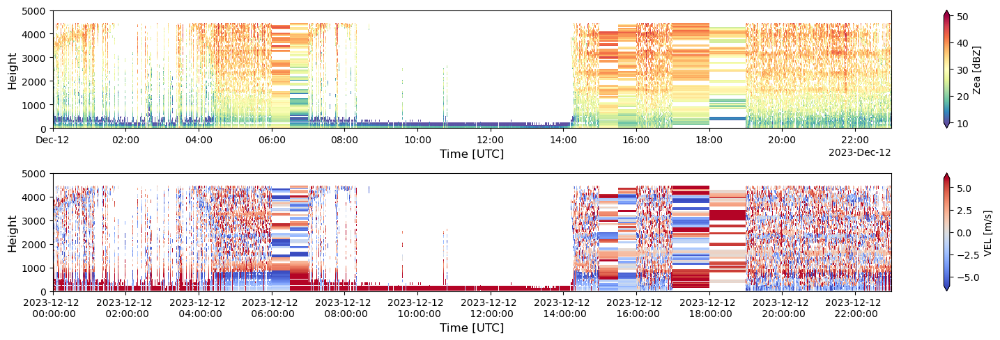

In [72]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Dec 12th Processed.png', dpi=300, bbox_inches='tight')

In [73]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202312/20231216/*.nc')

In [74]:
ds

<xarray.Dataset>
Dimensions:                       (time: 6480, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-12-16T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 08/02/2024 18:16:05 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

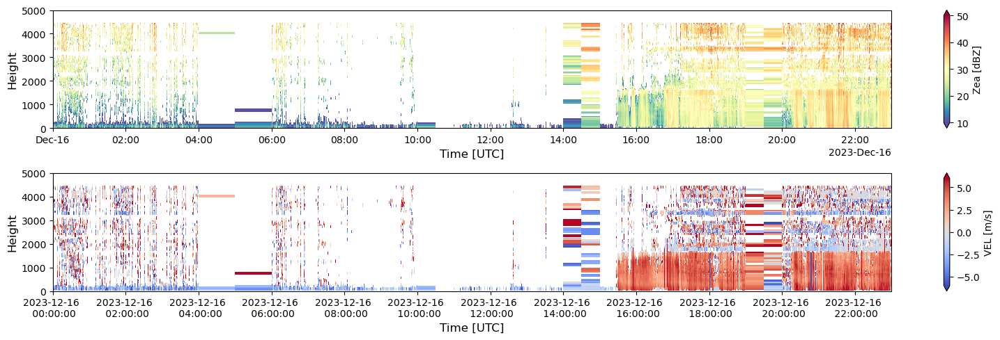

In [75]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Dec 16th Processed.png', dpi=300, bbox_inches='tight')

In [76]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202312/20231220/*.nc')

In [77]:
ds

<xarray.Dataset>
Dimensions:                       (time: 4320, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-12-20T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 08/02/2024 20:57:29 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

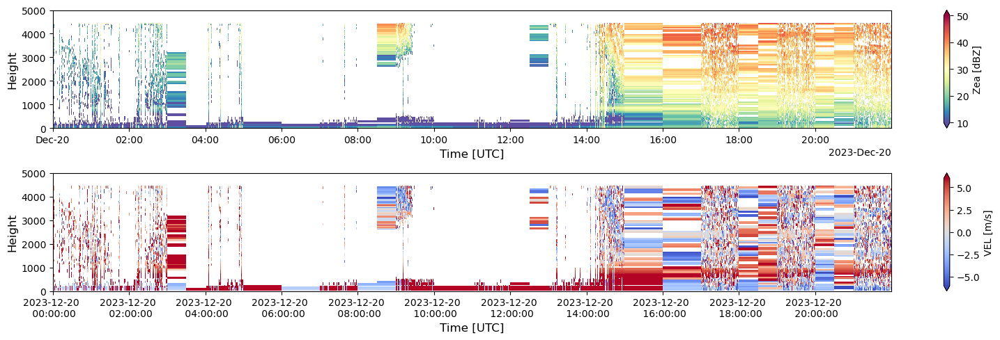

In [78]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Dec 20th Processed.png', dpi=300, bbox_inches='tight')

In [79]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202312/20231225/*.nc')

In [80]:
ds

<xarray.Dataset>
Dimensions:                       (time: 7920, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-12-25T01:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 08/02/2024 21:13:42 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

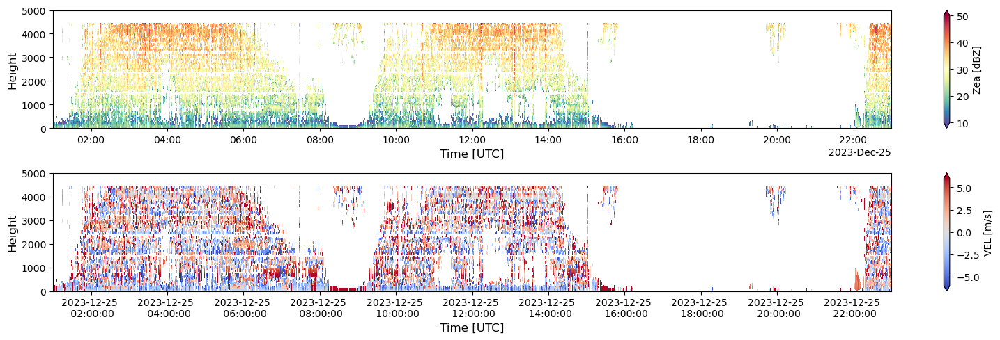

In [81]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Dec 25th Processed.png', dpi=300, bbox_inches='tight')

In [82]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202312/20231226/*.nc')

In [84]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-12-26T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 08/02/2024 21:35:57 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

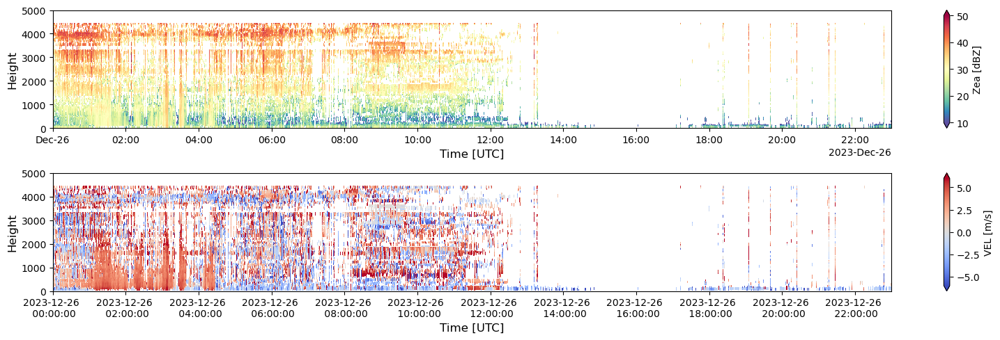

In [85]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Dec 26th Processed.png', dpi=300, bbox_inches='tight')

In [86]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202312/20231228/*.nc')

In [87]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-12-28T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 08/02/2024 21:57:37 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

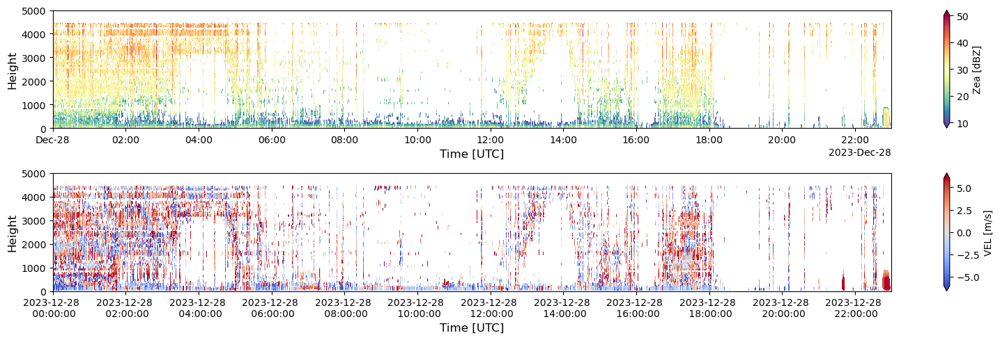

In [88]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Dec 28th Processed.png', dpi=300, bbox_inches='tight')

In [89]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202312/20231231/*.nc')

In [90]:
ds

<xarray.Dataset>
Dimensions:                       (time: 7920, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2023-12-31T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 08/02/2024 22:15:57 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

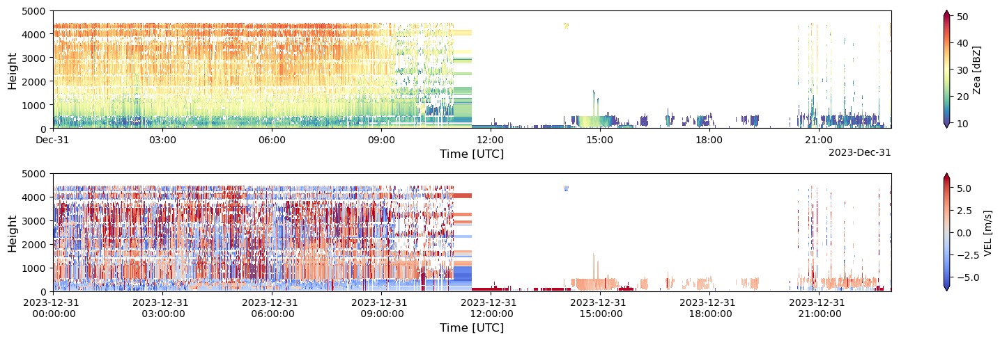

In [91]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('Dec 31st Processed.png', dpi=300, bbox_inches='tight')

In [92]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202401/20240101/*.nc')

In [93]:
ds

<xarray.Dataset>
Dimensions:                       (time: 7920, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2024-01-01T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 08/02/2024 22:32:56 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

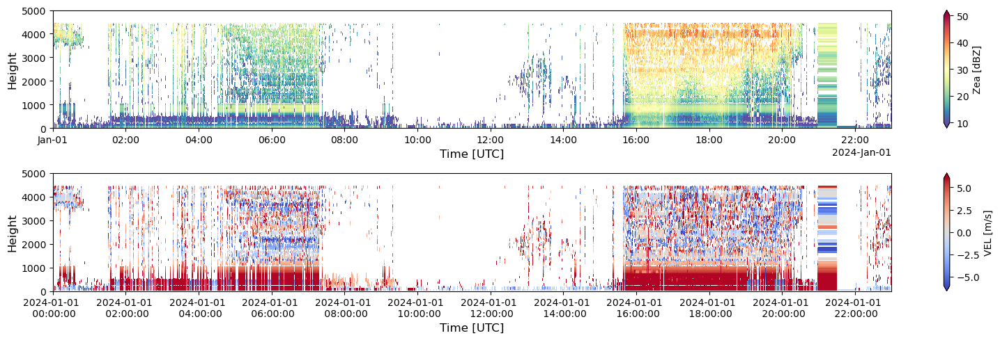

In [94]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('January 1st Processed.png', dpi=300, bbox_inches='tight')

In [95]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202401/20240103/*.nc')

In [96]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2024-01-03T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 09/02/2024 18:30:35 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

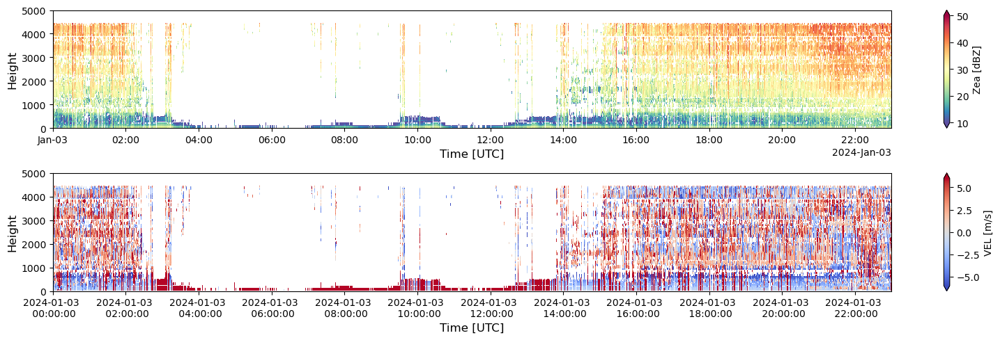

In [97]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('January 3rd Processed.png', dpi=300, bbox_inches='tight')

In [98]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202401/20240105/*.nc')

In [99]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2024-01-05T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 09/02/2024 18:51:36 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

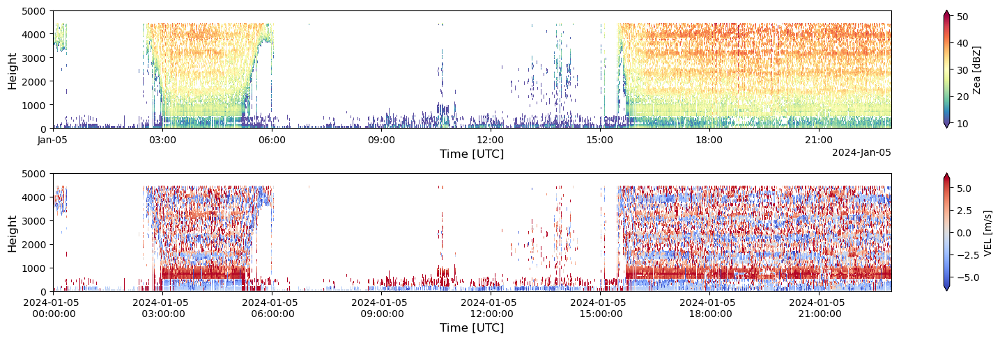

In [100]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('January 5th Processed.png', dpi=300, bbox_inches='tight')

In [101]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202401/20240106/*.nc')

In [102]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2024-01-06T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 12/02/2024 18:07:44 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

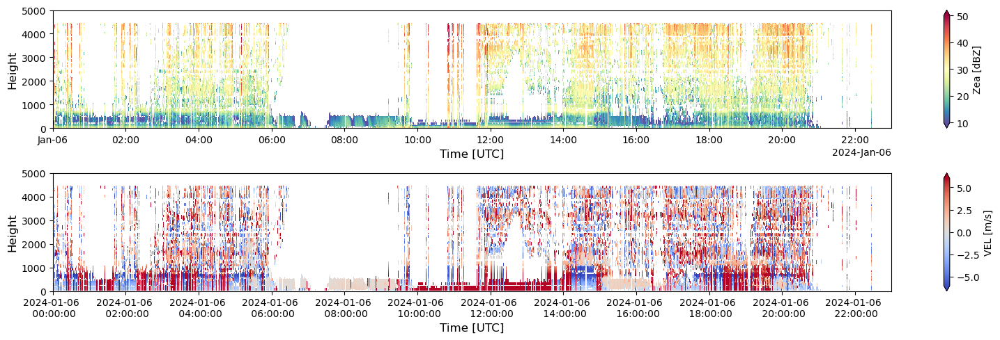

In [103]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('January 6th Processed.png', dpi=300, bbox_inches='tight')

In [104]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202401/20240107/*.nc')

In [105]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2024-01-07T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 12/02/2024 18:25:42 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

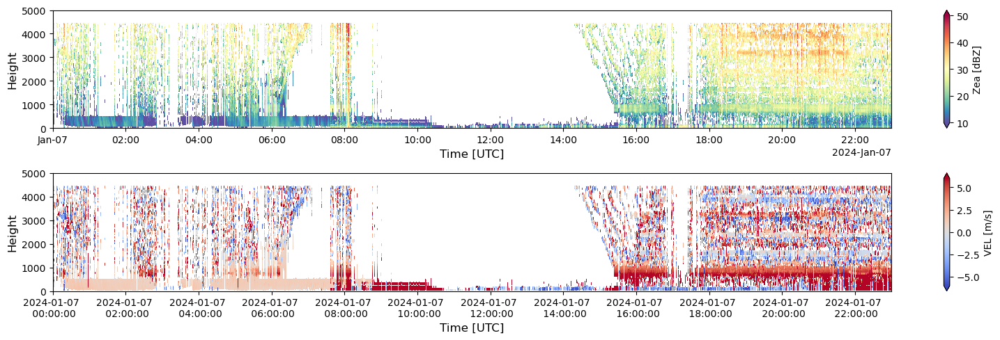

In [106]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('January 7th Processed.png', dpi=300, bbox_inches='tight')

In [107]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202401/20240109/*.nc')

In [108]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2024-01-09T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 12/02/2024 18:46:18 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

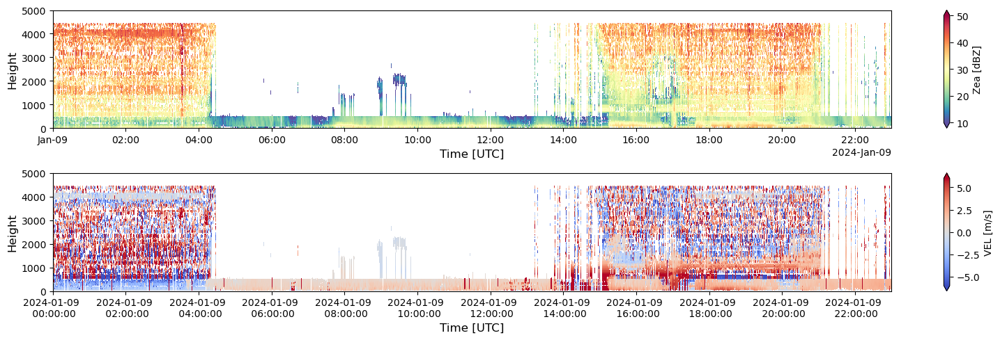

In [109]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('January 9th Processed.png', dpi=300, bbox_inches='tight')

In [110]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202401/20240110/*.nc')

In [111]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8234, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2024-01-10T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 12/02/2024 19:26:06 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

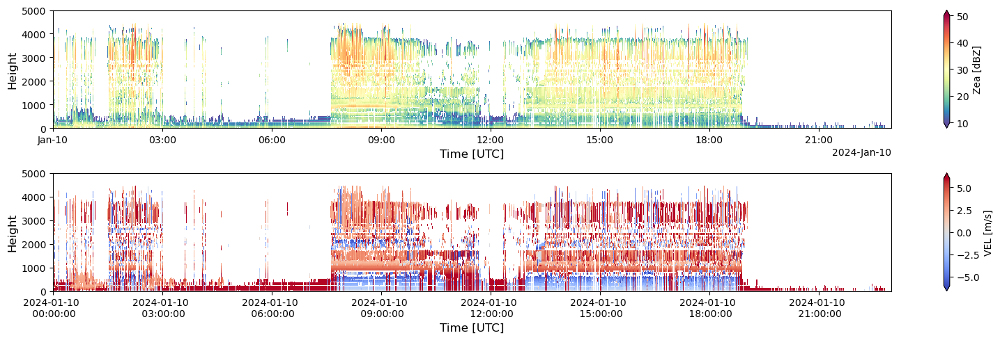

In [112]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('January 10th Processed.png', dpi=300, bbox_inches='tight')

In [113]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202401/20240112/*.nc')

In [114]:
ds

<xarray.Dataset>
Dimensions:                       (time: 8280, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2024-01-12T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 12/02/2024 19:52:03 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

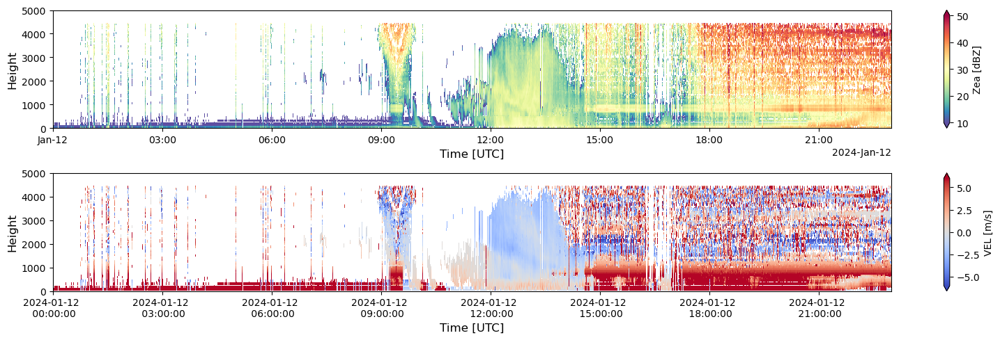

In [115]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('January 12th Processed.png', dpi=300, bbox_inches='tight')

In [116]:
ds = xr.open_mfdataset('/nfs/gce/projects/crocus/data/early_in_project_ingested_data/neiu-mrrpro/processed/202401/20240113/*.nc')

In [117]:
ds

<xarray.Dataset>
Dimensions:                       (time: 720, range: 128,
                                   spectrum_n_samples_extended: 192,
                                   spectrum_n_samples: 64)
Coordinates:
  * range                         (range) float32 0.0 35.0 ... 4.445e+03
  * time                          (time) datetime64[ns] 2024-01-13T00:00:00.0...
    elevation                     (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
    azimuth                       (time) float32 dask.array<chunksize=(360,), meta=np.ndarray>
Dimensions without coordinates: spectrum_n_samples_extended, spectrum_n_samples
Data variables:
    spectrum_reflectivity         (time, range, spectrum_n_samples_extended) float64 dask.array<chunksize=(1, 128, 192), meta=np.ndarray>
    Zea                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    VEL                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    WIDTH                         (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    SNR                           (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_level                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    noise_floor                   (time, range) float64 dask.array<chunksize=(1, 128), meta=np.ndarray>
    flag_spectrum_reconstruction  (time, range, spectrum_n_samples) float64 dask.array<chunksize=(1, 128, 64), meta=np.ndarray>
Attributes:
    Conventions:      CF/Radial
    version:          1.3
    title:            METEK MRR Pro 1.2.5 Data - Re-processed with ASPRO
    institution:      
    references:       
    source:           
    history:          Re-processed with ASPRO on 12/02/2024 20:46:51 UTC
    comment:          
    instrument_name:  METEK MRR Pro 1.2.5, ID: MRRPro97, METEK Serial Number:...
    site_name:        cms-mrr-002
    field_names:      spectrum_reflectivity,Zea,VEL,WIDTH,SNR,noise_level,noi...

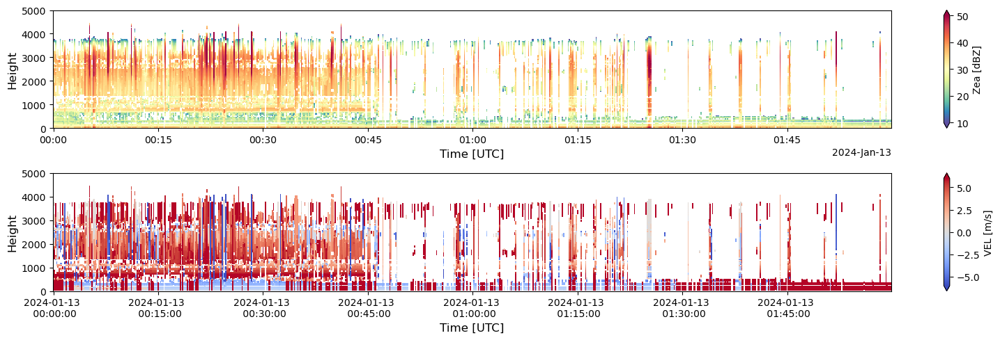

In [118]:
fig, ax = plt.subplots(2, 1, figsize=(16, 5))
ds["Zea"].T.plot(cmap='Spectral_r', vmin=10, vmax=50, ax=ax[0])
ax[0].set_xlabel('Time [UTC]', fontsize=12), ax[0].set_ylabel('Height', fontsize=12)
ax[0].set_ylim(0, 5000)
ds["VEL"].T.plot(cmap='coolwarm', vmin=-6, vmax=6, ax=ax[1])
ax[1].set_xlabel('Time [UTC]', fontsize=12), ax[1].set_ylabel('Height', fontsize=12)
ax[1].set_ylim(0, 5000)
date_form = DateFormatter("%Y-%m-%d \n %H:%M:%S")
plt.gca().xaxis.set_major_formatter(date_form)
fig.tight_layout()
plt.savefig('January 13th Processed.png', dpi=300, bbox_inches='tight')